The objective of this project is to do audio classification. We are going to do music genre classification. The dataset has been obtained from the following url: http://marsyas.info/downloads/datasets.html

We are going to use Google Colab for this project as it facilitates the usage of free GPU.

In [0]:
#commenting the below 2 lines as it contains information related to my Google account
#from google.colab import drive
#drive.mount('/content/drive')

In [0]:
import tarfile
import pandas as pd
import numpy as np
import os, shutil
from math import ceil, floor
from IPython.display import display, Audio
from PIL import Image

In [0]:
def delete_file_directory(path, isDirectory):
  if isDirectory:
    shutil.rmtree(path)
  else:
    os.remove(path)

In [0]:
def handle_tarfile(filePath):
  
  if filePath.endswith('tar.gz'):
    tarContent = tarfile.open(filePath, "r:gz")
  else:
    tarContent = tarfile.open(filePath, "r:")

  tarContent.extractall()
  tarContent.close()

In [0]:
handle_tarfile('drive/My Drive/datasets/music_genre/genres.tar.gz')

In [7]:
os.listdir('genres')

['bextract_single.mf',
 'di.mf',
 'cl.mf',
 'input.mf',
 'ja.mf',
 'disco',
 'bl.mf',
 'hiphop',
 'jazz',
 'po.mf',
 'hi.mf',
 'country',
 'ro.mf',
 're.mf',
 'pop',
 'blues',
 'co.mf',
 'metal',
 'me.mf',
 'classical',
 'rock',
 'reggae']

In [0]:
genres_list = []
for content in os.listdir('genres'):
  if not content.endswith('.mf'):
    genres_list.append(content)

In [10]:
genres_list

['disco',
 'hiphop',
 'jazz',
 'country',
 'pop',
 'blues',
 'metal',
 'classical',
 'rock',
 'reggae']

In [11]:
len(genres_list)

10

In [14]:
for cur_genre in genres_list:
  print('number of files in the genre {}'.format(cur_genre))
  print(len(os.listdir('genres/'+cur_genre)))

number of files in the genre disco
100
number of files in the genre hiphop
100
number of files in the genre jazz
100
number of files in the genre country
100
number of files in the genre pop
100
number of files in the genre blues
100
number of files in the genre metal
100
number of files in the genre classical
100
number of files in the genre rock
100
number of files in the genre reggae
100


let us listen to one audio file from each music genre

In [20]:
for cur_genre in genres_list:
  print('current genre {}'.format(cur_genre))
  base_dir = 'genres/'+cur_genre
  audio_file = os.listdir(base_dir)[0]
  display(Audio(base_dir+'/'+audio_file))

current genre disco


current genre hiphop


current genre jazz


current genre country


current genre pop


current genre blues


current genre metal


current genre classical


current genre rock


current genre reggae


In [18]:
Audio('genres/blues/blues.00000.wav')

We will using the librosa python package for audio analysis

In [0]:
import librosa
import librosa.display
import matplotlib.pyplot as plt

We will take one audio file from each genre and start by plotting it's monophonic waveform

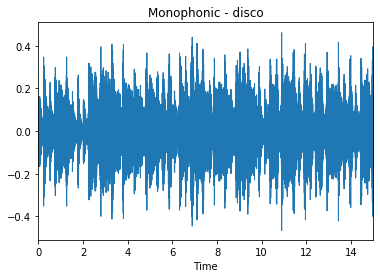

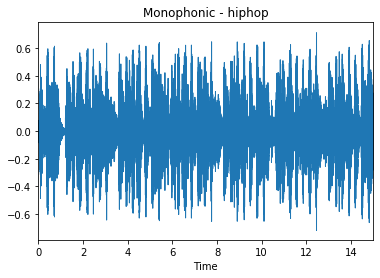

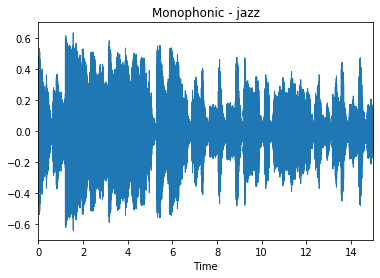

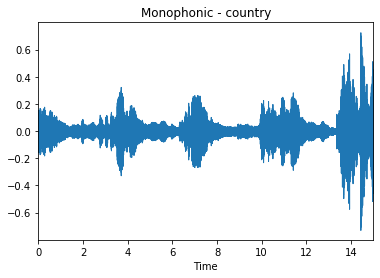

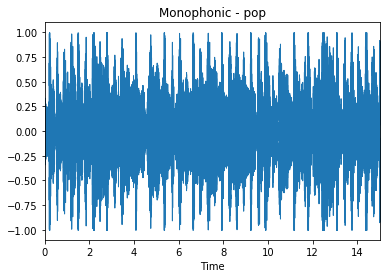

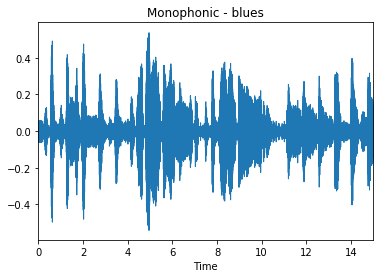

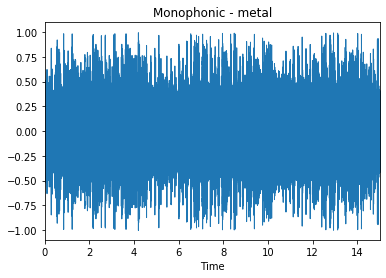

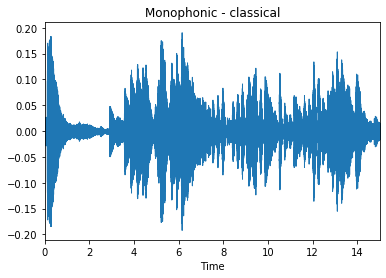

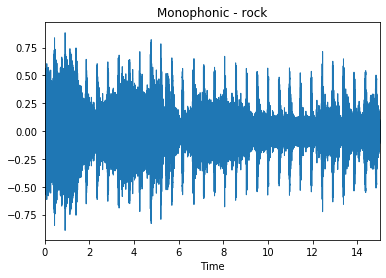

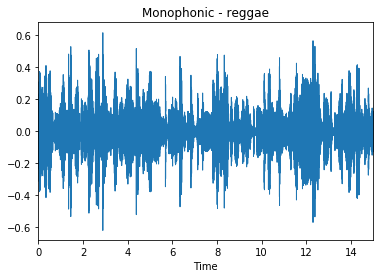

In [29]:
for cur_genre in genres_list:
  #print('current genre {}'.format(cur_genre))
  base_dir = 'genres/'+cur_genre
  audio_file = os.listdir(base_dir)[0]
  y, sr = librosa.load(base_dir+'/'+audio_file, duration=15)
  plt.figure()
  librosa.display.waveplot(y, sr=sr)
  plt.title('Monophonic - '+cur_genre)

Now, We will take one audio file from each genre and plot the mel scaled spectrogram

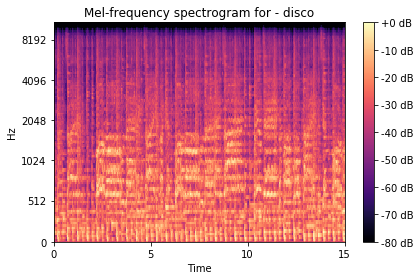

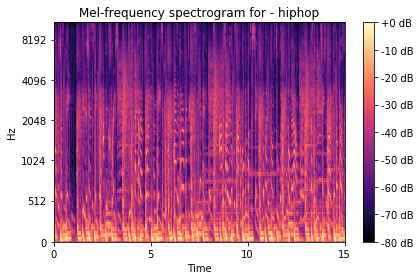

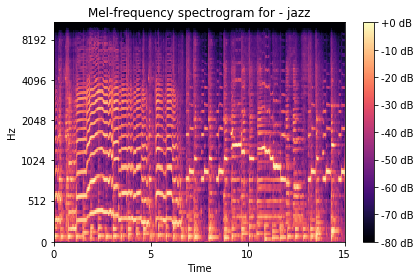

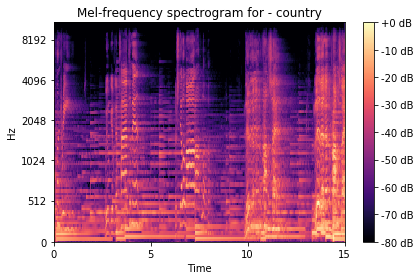

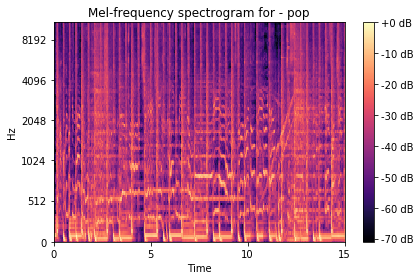

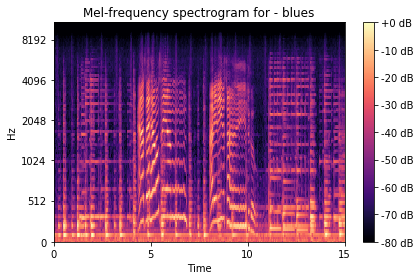

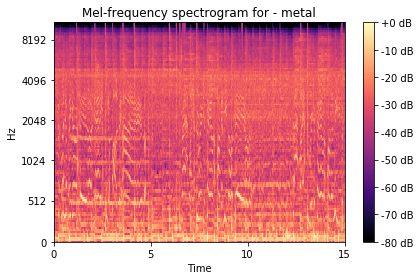

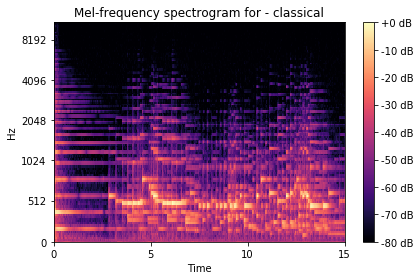

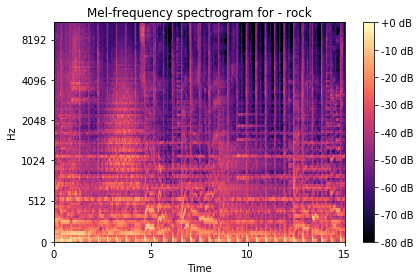

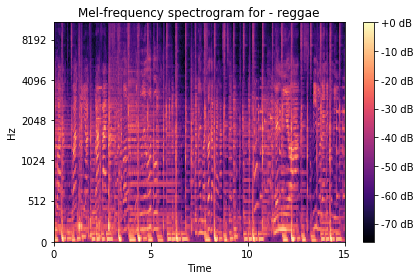

In [30]:
for cur_genre in genres_list:
  base_dir = 'genres/'+cur_genre
  audio_file = os.listdir(base_dir)[0]
  y, sr = librosa.load(base_dir+'/'+audio_file, duration=15)
  S = librosa.feature.melspectrogram(y=y, sr=sr)
  S_dB = librosa.power_to_db(S, ref=np.max)
  plt.figure()
  librosa.display.specshow(S_dB, x_axis='time', y_axis='mel', sr=sr)
  plt.colorbar(format='%+2.0f dB')
  plt.title('Mel-frequency spectrogram for - '+cur_genre)
  plt.tight_layout()

Now, We will take one audio file from each genre and plot the Chromagram

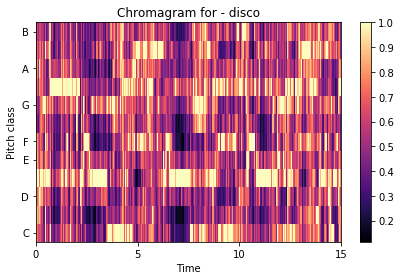

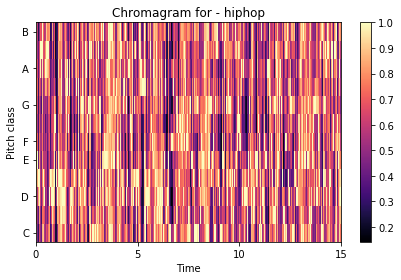

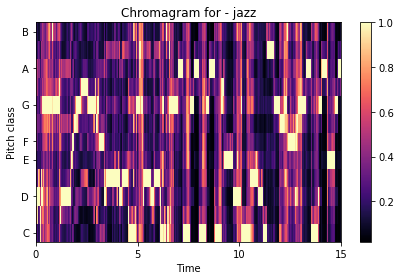

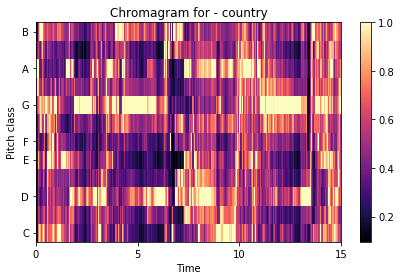

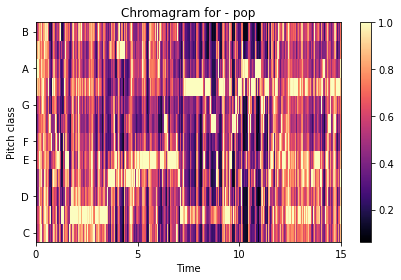

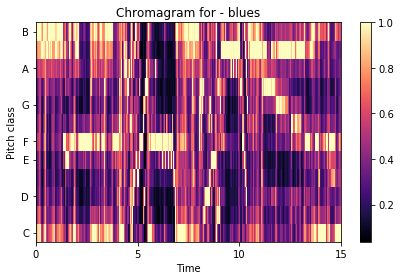

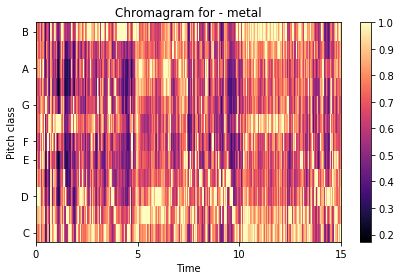

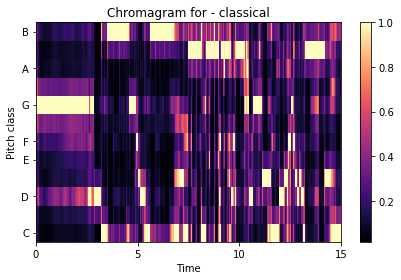

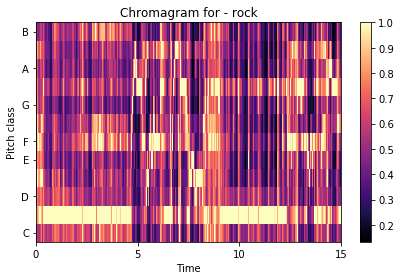

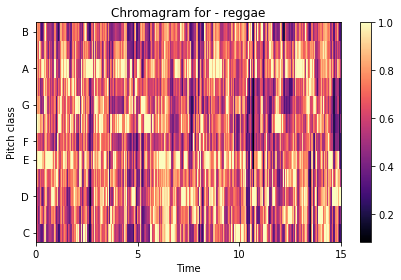

In [31]:
for cur_genre in genres_list:
  base_dir = 'genres/'+cur_genre
  audio_file = os.listdir(base_dir)[0]
  y, sr = librosa.load(base_dir+'/'+audio_file, duration=15)
  S = np.abs(librosa.stft(y))
  chroma = librosa.feature.chroma_stft(S=S, sr=sr)
  plt.figure()
  librosa.display.specshow(chroma, x_axis='time', y_axis='chroma', sr=sr)
  plt.colorbar()
  plt.title('Chromagram for - '+cur_genre)
  plt.tight_layout()

Now we are going to generate the mel scaled spectrogram plots and chromagram plots for all the audio files and save them as images

In [0]:
os.mkdir('mel_scaled_spectrogram_imgs')
os.mkdir('chromagram_imgs')

In [0]:
for cur_genre in genres_list:
  os.mkdir('mel_scaled_spectrogram_imgs/'+cur_genre)
  os.mkdir('chromagram_imgs/'+cur_genre)

In [0]:
def generate_mel_spectrogram_imgs():
  for cur_genre in genres_list:
    base_dir = 'genres/' + cur_genre
    audio_files = os.listdir(base_dir)
    for cur_audio_file in audio_files:
      y, sr = librosa.load(base_dir + '/' + cur_audio_file, duration=15)
      S = librosa.feature.melspectrogram(y=y, sr=sr)
      S_dB = librosa.power_to_db(S, ref=np.max)
      fig = plt.figure(figsize=(8,5))
      ax = plt.axes()
      ax.set_axis_off()
      librosa.display.specshow(S_dB, x_axis='time', y_axis='mel', sr=sr)
      img_name = cur_audio_file.split('.wav')[0] + '.png'
      img_path = 'mel_scaled_spectrogram_imgs/' + cur_genre + '/' + img_name
      plt.savefig(img_path, bbox_inches='tight', transparent=True, pad_inches=0.0 )
      plt.close(fig)


In [0]:
generate_mel_spectrogram_imgs()

In [0]:
def display_sample_imgs(path):
  for cur_genre in genres_list:
    print('current genre:', cur_genre)
    cur_genre_dir = path + cur_genre
    cur_imgs = os.listdir(cur_genre_dir)[:4]
    canvas_sheet_width = 1184
    canvas_sheet_height = 320
    canvas_sheet = Image.new('RGB', (canvas_sheet_width, canvas_sheet_height))
    x = 32
    for cur_img in cur_imgs:
      img = Image.open(cur_genre_dir + '/' + cur_img)
      img = img.resize((256,256))
      canvas_sheet.paste(img, (x, 32))
      x += 256 + 32
    display(canvas_sheet)

current genre: disco


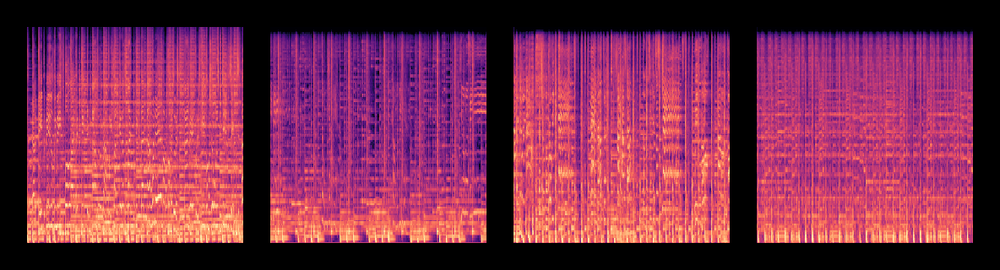

current genre: hiphop


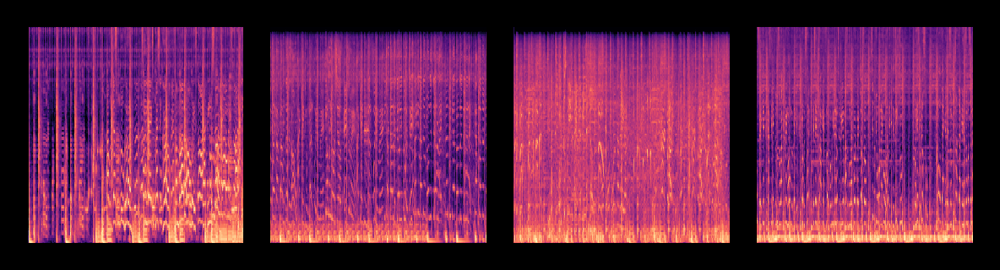

current genre: jazz


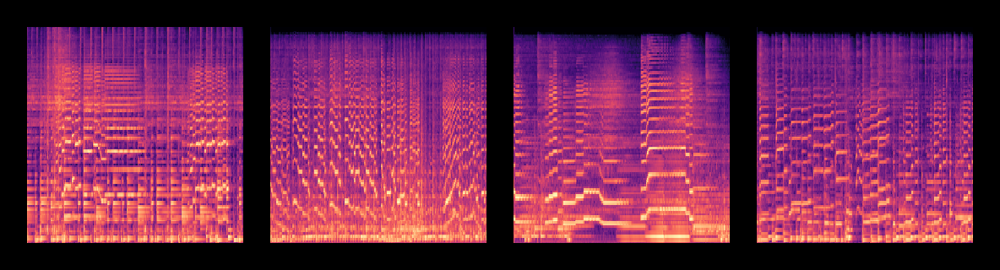

current genre: country


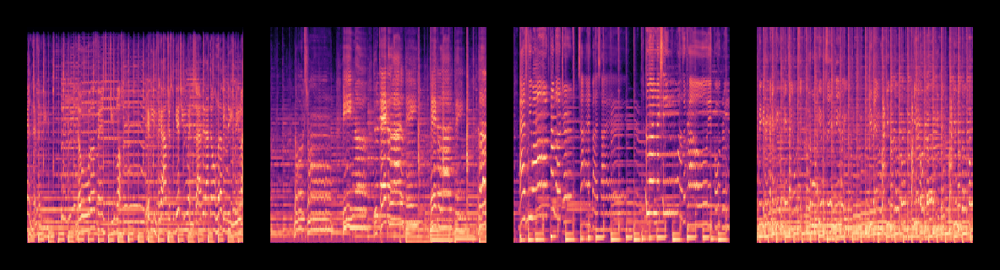

current genre: pop


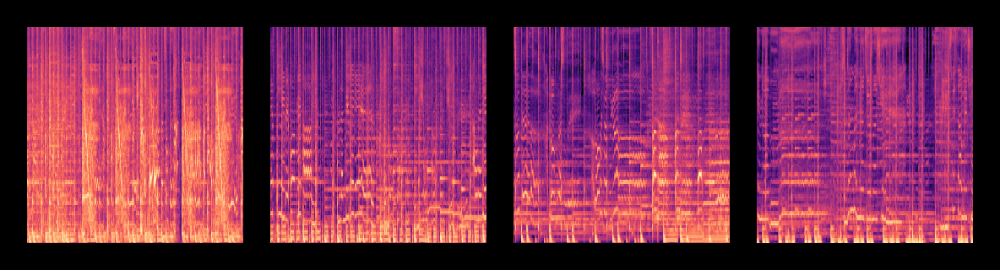

current genre: blues


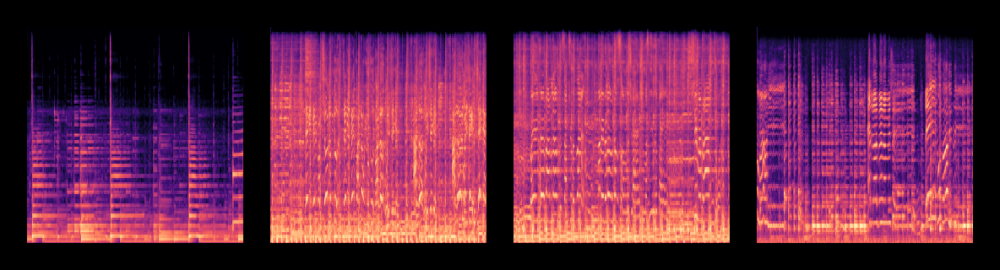

current genre: metal


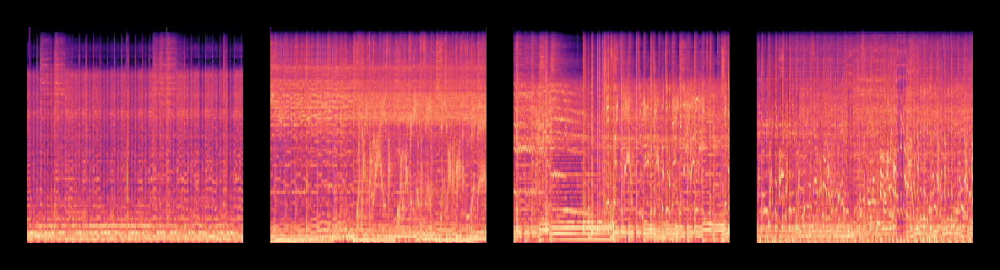

current genre: classical


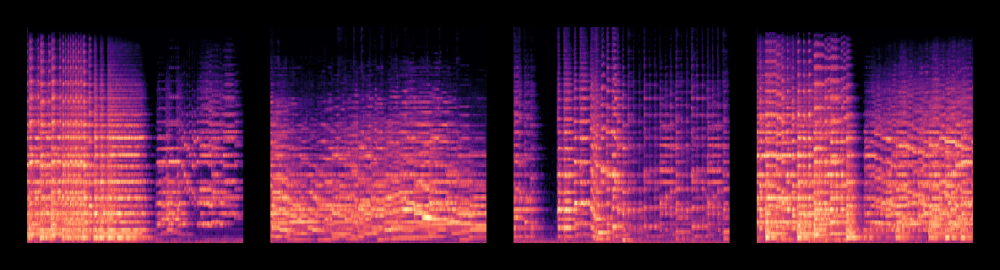

current genre: rock


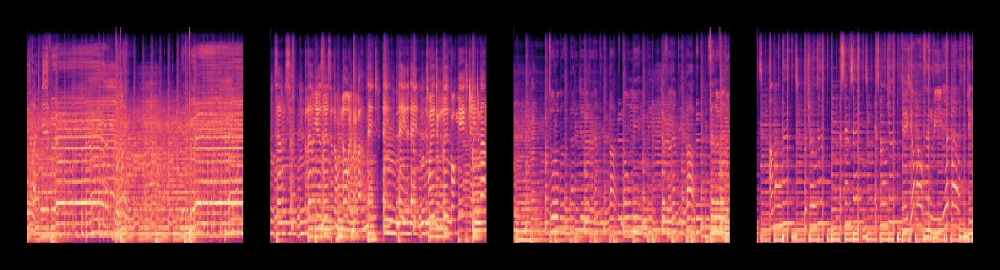

current genre: reggae


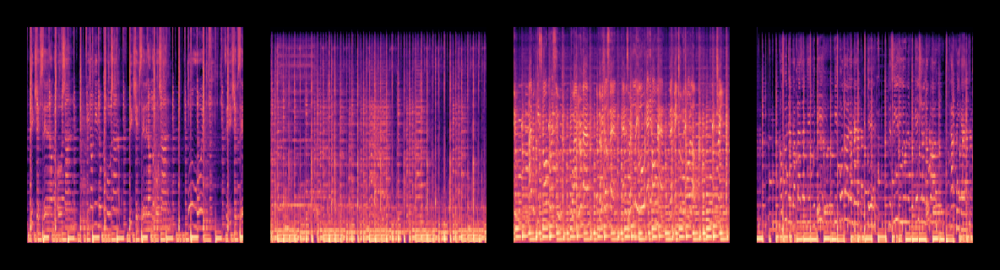

In [59]:
display_sample_imgs('mel_scaled_spectrogram_imgs/')